In [1]:
%reset -f

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.modules.loss import _Loss
import os
import torchvision
from torchvision.io.image import ImageReadMode
import matplotlib.pyplot as plt
import random
from torch.utils.data import Dataset, DataLoader, random_split
import tqdm
from typing import Callable
from enum import Enum
import math
import copy
import json
from datetime import datetime

torch.cuda.empty_cache()

In [2]:
class DenoiserDataset(Dataset):
    def __init__(self, data:torch.Tensor):
        self.data:torch.Tensor = data

    def __len__(self) -> int:
        return self.data.shape[0]

    def __getitem__(self, idx:int) -> torch.Tensor:
        return self.data[idx]

def load_dataset() -> list[torch.Tensor]:
    images_dir:str = os.path.join(os.getcwd(), "Dataset", "128x128")
    images_path:list[str] = os.listdir(images_dir)
    images:list[torch.Tensor] = list[torch.Tensor]()

    for image_local_path in images_path:
        image_absolute_path:str = os.path.join(images_dir, image_local_path)
        image:torch.Tensor = torchvision.io.read_image(image_absolute_path, ImageReadMode.RGB).type(torch.float32) / 255.0
        image = image * 2.0 - 1.0 # Extend the image for the [-1, 1] range
        images.append(image)
    return DenoiserDataset(torch.stack(images).cpu())

dataset:DenoiserDataset = load_dataset()

In [3]:
def plot_dataset_image(nb_image:int) -> None:
    for _ in range(0, nb_image):
        index:int = random.randint(0, len(dataset) - 1)
        image:torch.Tensor = dataset[index] * 0.5 + 0.5
        image = image.permute(1, 2, 0)
        plt.imshow(image)
        plt.show()
        
# plot_dataset_image(1)

In [4]:
class BetaSchedulerType(Enum):
    linear = 1
    cosine = 2

class UNetSetting:
    def __init__(self, in_channels:int, base_channels:int, time_emb_dim:int, attention_resolutions:list[int], image_size:int) -> None:
        self.in_channels:int = in_channels
        self.base_channels:int = base_channels
        self.time_emb_dim:int = time_emb_dim
        self.attention_resolutions:list[int] = attention_resolutions
        self.image_size:int = image_size

# Model hyperparameters
beta_scheduler_start:float = 1e-4
beta_scheduler_end:float = 0.02

#training params
in_channels:int = 3
base_channels:int = 128 # best practice is 128 but lower if lack of VRAM
time_emb_dim:int = 512
attention_resolutions:list[int] = [64, 32, 16] # [128, 64, 32, 16] is the best but try [64, 32, 16] is not enought VRAM, even [32, 16]
image_size:int = dataset[0].shape[1]
unet_setting = UNetSetting(in_channels, base_channels, time_emb_dim, attention_resolutions, image_size)

beta_schedule_type:BetaSchedulerType = BetaSchedulerType.linear
batch_size:int = 2
timestep:int = 1000
ema_decay:float = 0.999 # might use 0.9999
epochs:int = 500
test_proportion:float = 0.1

total_steps:int = epochs * (int(len(dataset) * (1.0 - test_proportion)) // batch_size)
base_lr:float = 1e-5
def lr_scheduler_fn(step:int) -> float:
    return base_lr

lr_scheduler:Callable[[int], float] = lr_scheduler_fn

# To plot lr curve, uncomment the line below
# X:list[float] = [float(i) for i in range(0, total_steps)]
# Y:list[float] = [lr_scheduler_fn(i) for i in range(0, total_steps )]
# plt.plot(X, Y)
# plt.show()

saving_epoch_interval:int = 40
print_epoch_interval:int = 10
nb_sample_to_print:int = 1
device:str = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device :{device}")

Device :cuda


In [5]:
def sinusoidal_embedding(timesteps:torch.Tensor, dim:int) -> torch.Tensor:
    """
    Create sinusoidal embeddings for timesteps.
    timesteps:(B,) tensor of integers
    dim:embedding dimension
    """
    device:str = timesteps.device
    half_dim:int = dim // 2
    emb = math.log(10000) / (half_dim - 1)
    emb = torch.exp(torch.arange(half_dim, device=device) * -emb)
    emb = timesteps[:, None] * emb[None, :]
    emb = torch.cat([torch.sin(emb), torch.cos(emb)], dim=1)
    return emb  # shape (B, dim)

class AttentionBlock(nn.Module):
    def __init__(self, channels:int, num_heads:int=4, groups=8):
        super().__init__()
        self.num_heads:int = num_heads
        self.norm:nn.GroupNorm = nn.GroupNorm(groups, channels)
        self.qkv:nn.Conv2d = nn.Conv2d(channels, channels * 3, 1)
        self.proj:nn.Conv2d = nn.Conv2d(channels, channels, 1)
        
    def forward(self, x:torch.Tensor) -> torch.Tensor:
        B:int = 0
        C:int = 0
        H:int = 0
        W:int = 0
        B, C, H, W = x.shape
        qkv:torch.Tensor = self.qkv(self.norm(x))

        chunks:tuple[torch.Tensor] = qkv.chunk(3, dim=1)
        q:torch.Tensor = chunks[0]
        k:torch.Tensor = chunks[1]
        v:torch.Tensor = chunks[2]
        
        q = q.reshape(B, self.num_heads, C // self.num_heads, H * W)
        k = k.reshape(B, self.num_heads, C // self.num_heads, H * W)
        v = v.reshape(B, self.num_heads, C // self.num_heads, H * W)
        
        attn:torch.Tensor = torch.einsum('bhcd,bhce->bhde', q, k) / math.sqrt(C // self.num_heads)
        attn = F.softmax(attn, dim=-1)
        
        out:torch.Tensor = torch.einsum('bhde,bhce->bhcd', attn, v)
        out = out.reshape(B, C, H, W)
        return x + self.proj(out)

class ResBlock(nn.Module):
    def __init__(self, in_channels, out_channels, time_emb_dim, dropout=0.1, groups=8):
        super().__init__()
        self.norm1:nn.GroupNorm = nn.GroupNorm(groups, in_channels)
        self.act1:nn.SiLU = nn.SiLU()
        self.conv1:nn.Conv2d = nn.Conv2d(in_channels, out_channels, 3, padding=1)
        
        self.time_mlp:nn.Sequential = nn.Sequential(
            nn.SiLU(),
            nn.Linear(time_emb_dim, out_channels)
        )
        
        self.norm2:nn.GroupNorm = nn.GroupNorm(8, out_channels)
        self.act2:nn.SiLU = nn.SiLU()
        self.dropout:nn.Dropout = nn.Dropout(dropout)
        self.conv2:nn.Conv2d = nn.Conv2d(out_channels, out_channels, 3, padding=1)

        self.res_conv:nn.Conv2d = nn.Conv2d(in_channels, out_channels, 1) if in_channels != out_channels else nn.Identity()
        
    def forward(self, x:torch.Tensor, t_emb:torch.Tensor) -> torch.Tensor:
        h:torch.Tensor = self.norm1(x)
        h = self.act1(h)
        h = self.conv1(h)

        t_emb:torch.Tensor = self.time_mlp(t_emb)[:, :, None, None]
        h = h + t_emb
        h = self.norm2(h)
        h = self.act2(h)
        h = self.dropout(h)
        h = self.conv2(h)
        return h + self.res_conv(x)

#V0.2
class UNet(nn.Module):
    def __init__(self, in_channels:int, base_channels:int, time_emb_dim:int, attention_resolutions:list[int], image_size:int, dropout:float=0.1, num_heads:int=4,groups:int = 8):
        super().__init__()
        self.image_size:int = image_size

        s_in:int = image_size
        s_d1:int = image_size // 2
        s_d2:int = image_size // 4
        s_d3:int = image_size // 8

        self.time_mlp:nn.Sequential = nn.Sequential(
            nn.Linear(time_emb_dim, time_emb_dim * 4),
            nn.SiLU(),
            nn.Linear(time_emb_dim * 4, time_emb_dim)
        )

        self.conv_in:nn.Conv2d = nn.Conv2d(in_channels, base_channels, 3, padding=1)

        def AttnOrId(ch:int, res:int) -> nn.Module | nn.Identity:
            return AttentionBlock(ch, num_heads=num_heads) if res in attention_resolutions else nn.Identity()

        self.down1:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels, base_channels, time_emb_dim, dropout, groups),
            AttnOrId(base_channels, s_in),
            ResBlock(base_channels, base_channels, time_emb_dim, dropout, groups),
            AttnOrId(base_channels, s_in),
        ])
        self.downsample1:nn.Conv2d = nn.Conv2d(base_channels, base_channels * 2, 4, 2, 1)

        self.down2:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels * 2, base_channels * 2, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 2, s_d1),
            ResBlock(base_channels * 2, base_channels * 2, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 2, s_d1),
        ])
        self.downsample2:nn.Conv2d = nn.Conv2d(base_channels * 2, base_channels * 4, 4, 2, 1)

        self.down3:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels * 4, base_channels * 4, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 4, s_d2),
            ResBlock(base_channels * 4, base_channels * 4, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 4, s_d2),
        ])
        self.downsample3:nn.Conv2d = nn.Conv2d(base_channels * 4, base_channels * 8, 4, 2, 1)

        self.mid1:ResBlock = ResBlock(base_channels * 8, base_channels * 8, time_emb_dim, dropout, groups)
        self.mid_attn:nn.Module = AttnOrId(base_channels * 8, s_d3)
        self.mid2:ResBlock = ResBlock(base_channels * 8, base_channels * 8, time_emb_dim, dropout, groups)

        self.upsample1:nn.ConvTranspose2d = nn.ConvTranspose2d(base_channels * 8, base_channels * 4, 4, 2, 1)
        self.up1:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels * 8, base_channels * 4, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 4, s_d2),
            ResBlock(base_channels * 4, base_channels * 4, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 4, s_d2),
        ])

        self.upsample2:nn.ConvTranspose2d = nn.ConvTranspose2d(base_channels * 4, base_channels * 2, 4, 2, 1)
        self.up2:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels * 4, base_channels * 2, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 2, s_d1),
            ResBlock(base_channels * 2, base_channels * 2, time_emb_dim, dropout, groups),
            AttnOrId(base_channels * 2, s_d1),
        ])

        self.upsample3:nn.ConvTranspose2d = nn.ConvTranspose2d(base_channels * 2, base_channels, 4, 2, 1)
        self.up3:nn.ModuleList = nn.ModuleList([
            ResBlock(base_channels * 2, base_channels, time_emb_dim, dropout, groups),
            AttnOrId(base_channels, s_in),
            ResBlock(base_channels, base_channels, time_emb_dim, dropout, groups),
            AttnOrId(base_channels, s_in),
        ])

        self.norm_out:nn.GroupNorm = nn.GroupNorm(groups, base_channels)
        self.act_out:nn.SiLU = nn.SiLU()
        self.conv_out:nn.Conv2d = nn.Conv2d(base_channels, in_channels, 3, padding=1)

    def forward(self, x:torch.Tensor, t:torch.Tensor) -> torch.Tensor:
        t_emb:torch.Tensor = sinusoidal_embedding(t.long(), self.time_mlp[0].in_features)
        t_emb = self.time_mlp(t_emb)

        h1:torch.Tensor = self.conv_in(x)
        for block in self.down1:
            h1 = block(h1, t_emb) if isinstance(block, ResBlock) else block(h1)
        h2:torch.Tensor = self.downsample1(h1)

        for block in self.down2:
            h2 = block(h2, t_emb) if isinstance(block, ResBlock) else block(h2)
        h3:torch.Tensor = self.downsample2(h2)

        for block in self.down3:
            h3 = block(h3, t_emb) if isinstance(block, ResBlock) else block(h3)
        h4:torch.Tensor = self.downsample3(h3)

        h:torch.Tensor  = self.mid1(h4, t_emb)
        h  = self.mid_attn(h)
        h  = self.mid2(h, t_emb)

        h  = self.upsample1(h)
        h  = torch.cat([h, h3], dim=1)
        for block in self.up1:
            h = block(h, t_emb) if isinstance(block, ResBlock) else block(h)

        h  = self.upsample2(h)
        h  = torch.cat([h, h2], dim=1)
        for block in self.up2:
            h = block(h, t_emb) if isinstance(block, ResBlock) else block(h)

        h  = self.upsample3(h)
        h  = torch.cat([h, h1], dim=1)
        for block in self.up3:
            h = block(h, t_emb) if isinstance(block, ResBlock) else block(h)

        h  = self.norm_out(h)
        h  = self.act_out(h)
        return self.conv_out(h)

In [6]:
class DiffusionModel:
    def __init__(self, model:UNet, optimizer:torch.optim.Optimizer, criterion:_Loss, beta_schedule_type:BetaSchedulerType, timesteps:int, device:str) -> None:
        self.model:UNet = model.to(device)
        self.optimizer:torch.optim.Optimizer = optimizer
        self.criterion:_Loss = criterion
        self.timesteps:int = timesteps
        self.device:str = device
        
        if beta_schedule_type == BetaSchedulerType.linear:
            self.beta:torch.Tensor = torch.linspace(beta_scheduler_start, beta_scheduler_end, self.timesteps)
            self.alpha:torch.Tensor = 1.0 - self.beta
            self.alpha_bar:torch.Tensor = torch.cumprod(self.alpha, dim=0)
            alpha_bar_prev:torch.Tensor = torch.cat([torch.tensor([1.0]), self.alpha_bar[:-1]])
            self.posterior_variance:torch.Tensor = self.beta * ((1 - alpha_bar_prev) / (1 - self.alpha_bar))
        else:# beta_schedule_type == BetaSchedulerType.cosine
            s:float = 0.008
            x:torch.Tensor = torch.linspace(0, self.timesteps, self.timesteps + 1)
            self.alpha_bar:torch.Tensor = torch.cos(((x / self.timesteps) + s) / (1 + s) * torch.pi * 0.5) ** 2
            self.alpha_bar = self.alpha_bar / self.alpha_bar[0]
            self.beta:torch.Tensor = 1.0 - (self.alpha_bar[1:] / self.alpha_bar[:-1])
            self.beta = torch.clamp(self.beta, 1e-5, 0.999)
            self.alpha = 1.0 - self.beta
            alpha_bar_prev:torch.Tensor = torch.cat([torch.tensor([1.0]), self.alpha_bar[:-1]])
            self.posterior_variance:torch.Tensor = self.beta * ((1 - alpha_bar_prev) / (1 - self.alpha_bar))

    #x0.shape :(batch_size, in_channels, image_size, image_size)
    #t.shape :(batch_size,)
    def _add_noise(self, x0:torch.Tensor, t:torch.Tensor) -> tuple[torch.Tensor, torch.Tensor]:
        with torch.no_grad():
            noise:torch.Tensor = torch.randn(x0.shape)
            alpha_bar_t:torch.Tensor = self.alpha_bar[t].view(-1, 1, 1, 1) # this line is ok
            noisy_image:torch.Tensor = (torch.sqrt(alpha_bar_t) * x0) + (torch.sqrt(1 - alpha_bar_t) * noise)
            return noisy_image.to(self.device), noise.to(self.device)
        
    # x0 are the clean images of shape [batch_size, in_channels, image_size, image_size] on the CPU
    # return the loss, the noisy x0, the predicted noise and the noise apply to x0
    # loss is use for training, the rest for debugging purpose
    def train_step(self, x0:torch.Tensor) -> tuple[float, torch.Tensor, torch.Tensor, torch.Tensor]:
        self.optimizer.zero_grad()

        t:torch.Tensor = torch.randint(0, self.timesteps, (x0.shape[0],), dtype=torch.long)
        xt, noise = self._add_noise(x0, t)
        xt_detach:torch.Tensor = xt.detach().cpu().clone()
        noise_detach:torch.Tensor = noise.detach().cpu().clone()
        t = t.to(self.device)

        pred_noise:torch.Tensor = self.model(xt, t)
        pred_noise_detach:torch.Tensor = pred_noise.detach().cpu().clone()
        loss:torch.Tensor = self.criterion(pred_noise, noise)

        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.model.parameters(), 1.0)
        self.optimizer.step()

        return loss.cpu().item(), xt_detach, pred_noise_detach, noise_detach
    
    def train_step_test(self, x0:torch.Tensor) -> torch.Tensor:
        with torch.no_grad():
            t:torch.Tensor = torch.randint(0, self.timesteps, (x0.shape[0],), dtype=torch.long)
            xt, noise = self._add_noise(x0, t)
            t = t.to(self.device)
            pred_noise:torch.Tensor = self.model(xt, t)
            loss:torch.Tensor = self.criterion(pred_noise, noise)
            return loss.cpu().item()
        
    def sample(self, nb_sample:int, verbose:bool = False) -> torch.Tensor:
        with torch.no_grad():
            x:torch.Tensor = torch.randn((nb_sample, in_channels, image_size, image_size), device=self.device)

            if verbose:
                image:torch.Tensor = torch.clamp(x[0].detach().cpu() * 0.5 + 0.5, 0.0, 1.0)
                plt.imshow(image.permute(1, 2, 0))
                plt.show()

            for i, t in enumerate(reversed(range(0, self.timesteps))):
                t_tensor:torch.Tensor = torch.full((nb_sample,), t, device=self.device, dtype=torch.long)
                pred_noise:torch.Tensor = self.model(x, t_tensor)
                alpha_t:torch.Tensor = self.alpha[t].to(self.device)
                alpha_bar_t:torch.Tensor = self.alpha_bar[t].to(self.device)

                coeff1:torch.Tensor = (1.0 / torch.sqrt(alpha_t))
                coeff2:torch.Tensor = ((1.0 - alpha_t) / torch.sqrt(1.0 - alpha_bar_t))
                x =  coeff1 * (x - (coeff2 * pred_noise))

                if t > 0:
                    # DDIM-style variance interpolation, may be better than posterior_variance
                    # sigma_t:torch.Tensor = torch.sqrt(0.5 * self.posterior_variance[t] + (0.5 * self.beta[t]))
                    sigma_t:torch.Tensor = torch.sqrt(self.posterior_variance[t])
                    x += sigma_t * torch.randn_like(x)

                if verbose and i % (self.timesteps // 10) == 0:
                    image:torch.Tensor = torch.clamp(x[0].detach().cpu() * 0.5 + 0.5, 0.0, 1.0)
                    plt.imshow(image.permute(1, 2, 0))
                    plt.show()
                    
            return torch.clamp(x * 0.5 + 0.5, 0.0, 1.0).cpu()

In [7]:
class EMA:
    def __init__(self, model:UNet, decay:float):
        self.decay:float = decay
        self.ema_model:UNet = copy.deepcopy(model).cpu()
        self.ema_model.eval()
        for p in self.ema_model.parameters():
            p.requires_grad_(False)

    def update(self, model:UNet) -> None:
        with torch.no_grad():
            for ema_param, model_param in zip(self.ema_model.parameters(), model.parameters()):
                ema_param.data = ema_decay * ema_param.data + (1 - ema_decay) * model_param.data.cpu()

    def state_dict(self) -> dict[str, any]:
        return self.ema_model.state_dict()

    def load_state_dict(self, state_dict) -> None:
        self.ema_model.load_state_dict(state_dict)

In [8]:
def load_denoiser(file:str) -> UNet:
    model:UNet = UNet(unet_setting.in_channels, unet_setting.base_channels, unet_setting.time_emb_dim, unet_setting.attention_resolutions, unet_setting.image_size)
    model_path:str = os.path.join(os.getcwd(), "Models", file)
    model.load_state_dict(torch.load(model_path, weights_only=True))
    model.eval()
    return model

# denoiser = load_denoiser("denoiser.model")

def show_denoiser_size(model:UNet) -> None:
    param_size = 0
    for param in model.parameters():
        param_size += param.nelement() * param.element_size()

    size_all_mb = (param_size + 0) / (1024**2)
    print("Model size:{:.3f} MB with {} parameters".format(size_all_mb, sum(p.numel() for p in model.parameters())))

In [9]:
class TrainResult:
    epoch:int
    train_losses:list[float]
    test_losses:list[float]

    @staticmethod
    def from_json(json_str:str) -> 'TrainResult':
        d = json.loads(json_str)
        return TrainResult(**d)

    def __init__(self, epoch:int, train_losses:list[float], test_losses:list[float]) -> None:
        self.epoch = epoch
        self.train_losses = train_losses
        self.test_losses = test_losses

    def to_json(self) -> str:
        return json.dumps(self.__dict__, indent=4)

Start training UNet


Training model:  52%|█████▏    | 379600/730000 [29:27<16:15:49,  5.98it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8382944..1.5575006].


Noisy image :


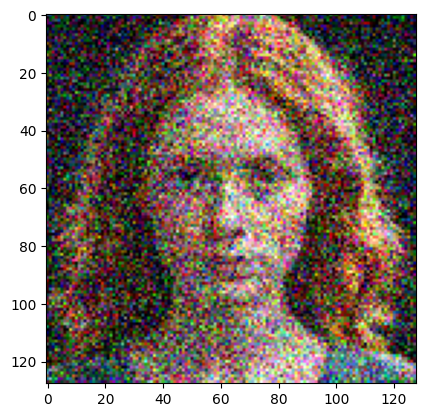

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6646252..2.5708222].


Predict noise :


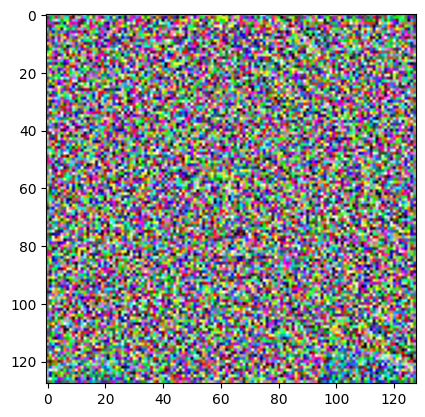

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6886144..2.473066].


Added noise :


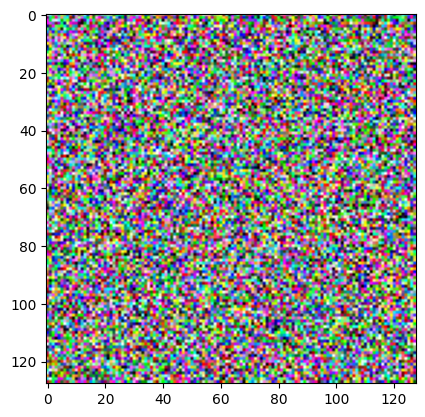

Training model:  54%|█████▍    | 394200/730000 [1:11:28<15:33:23,  6.00it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.92872..1.774211].


Noisy image :


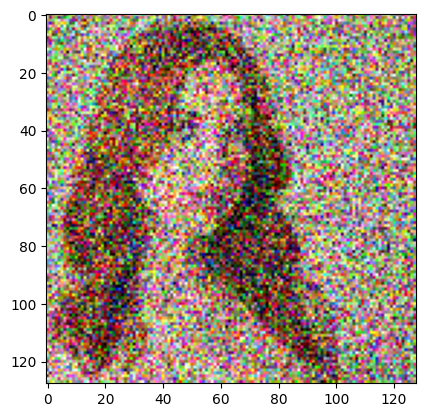

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5615497..2.391676].


Predict noise :


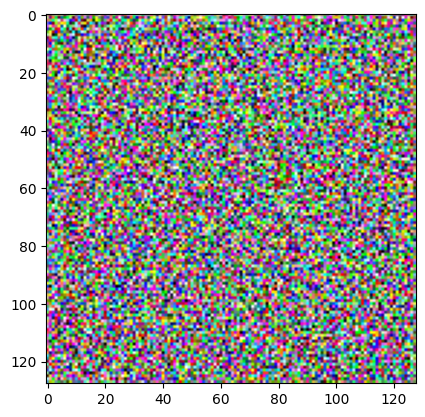

Added noise :


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6145701..2.4265609].


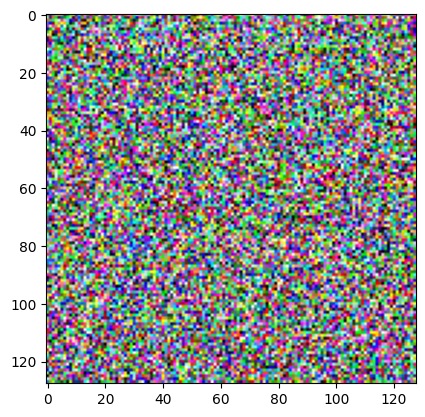

Training model:  56%|█████▌    | 408800/730000 [1:53:31<14:52:15,  6.00it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2178462..2.248537].


Noisy image :


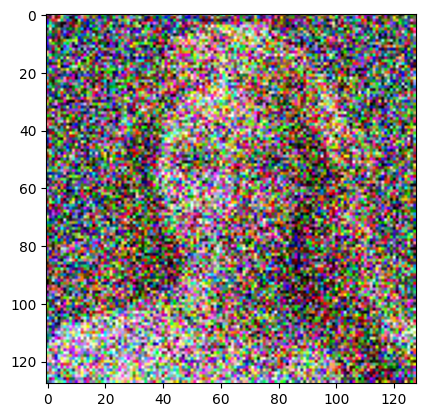

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6625683..2.5135808].


Predict noise :


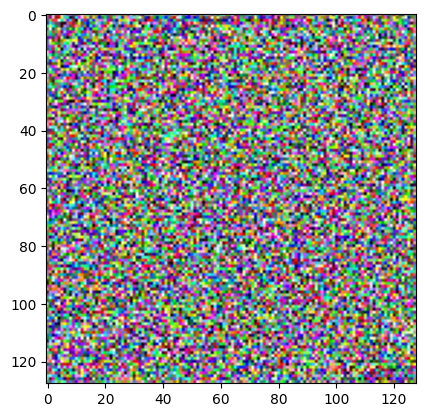

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4817519..2.650536].


Added noise :


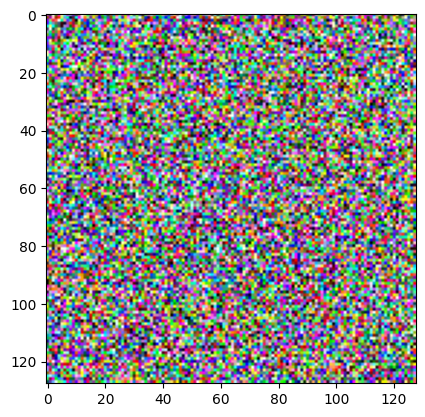

Training model:  58%|█████▊    | 423400/730000 [2:35:35<14:08:59,  6.02it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3888476..2.570877].


Noisy image :


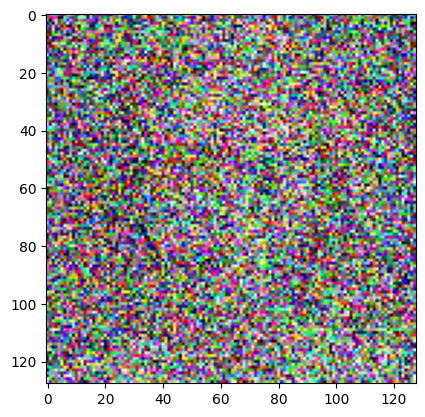

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4477022..2.550595].


Predict noise :


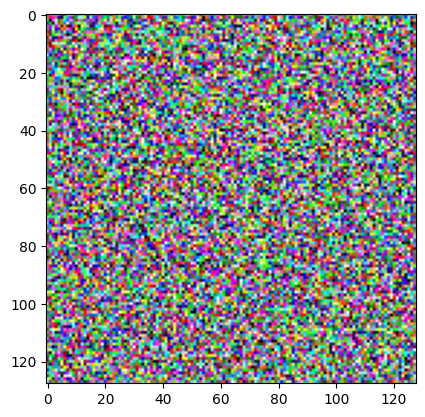

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5033965..2.6855936].


Added noise :


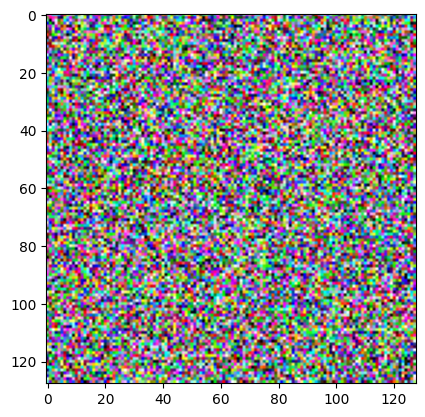

Training model:  60%|██████    | 438000/730000 [3:17:42<13:32:06,  5.99it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7363222..2.580792].


Noisy image :


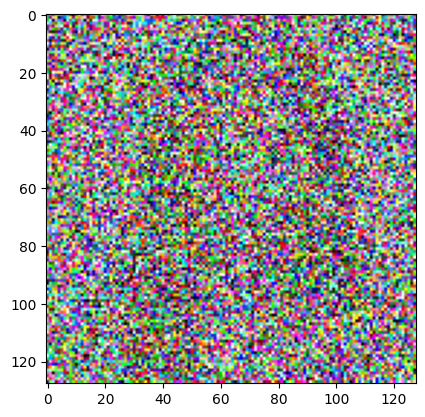

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.628799..2.5286553].


Predict noise :


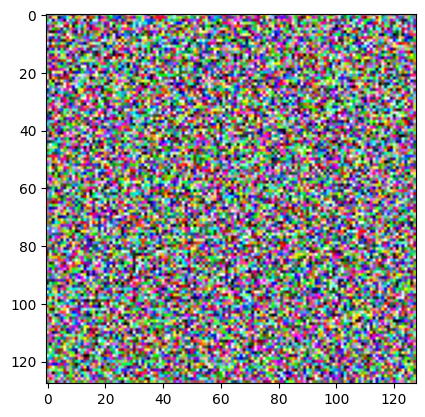

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7781286..2.5840764].


Added noise :


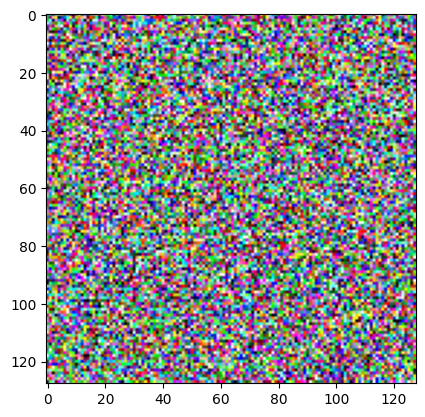

Training model:  62%|██████▏   | 452600/730000 [3:59:49<12:50:23,  6.00it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.483499..2.3679261].


Noisy image :


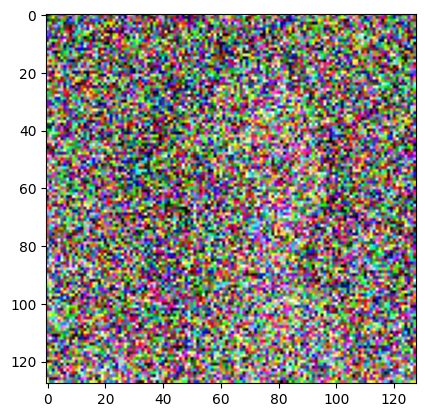

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4265528..2.5396144].


Predict noise :


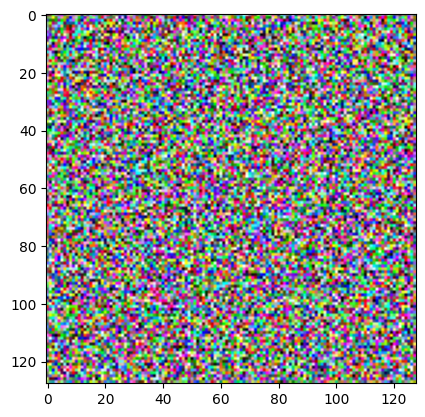

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4752967..2.5456345].


Added noise :


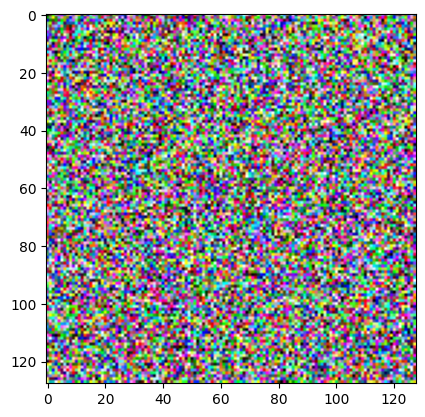

Training model:  64%|██████▍   | 467200/730000 [4:41:55<12:08:04,  6.02it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.3375066..1.3223658].


Noisy image :


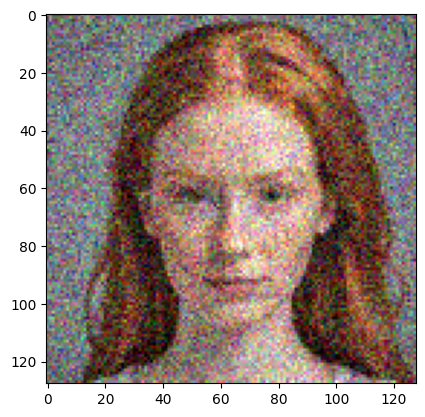

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5227668..2.2626877].


Predict noise :


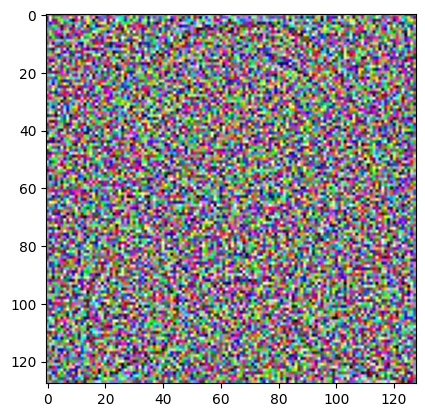

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6319976..2.5344121].


Added noise :


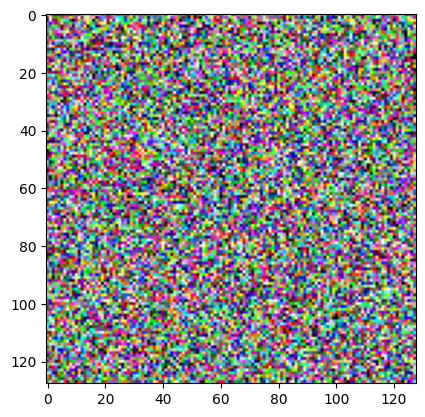

Training model:  66%|██████▌   | 481800/730000 [5:24:01<11:29:45,  6.00it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.697279..2.6315525].


Noisy image :


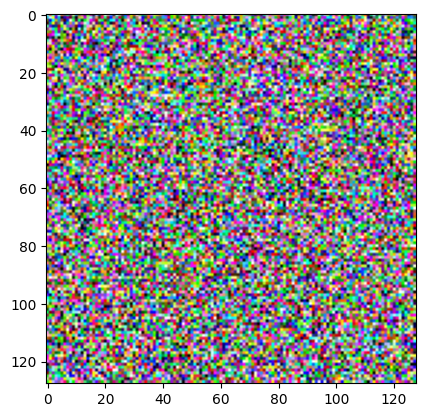

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7068717..2.5731].


Predict noise :


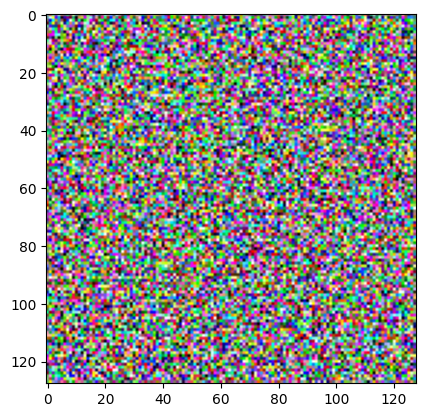

Added noise :


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6984642..2.637749].


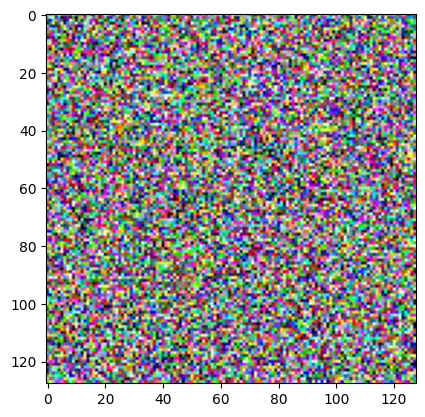

Training model:  68%|██████▊   | 496400/730000 [6:06:07<10:49:47,  5.99it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9002154..2.5151615].


Noisy image :


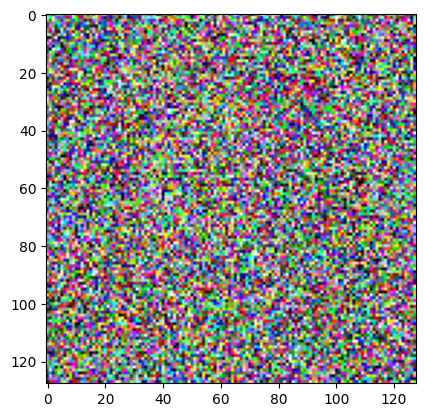

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9451365..2.605991].


Predict noise :


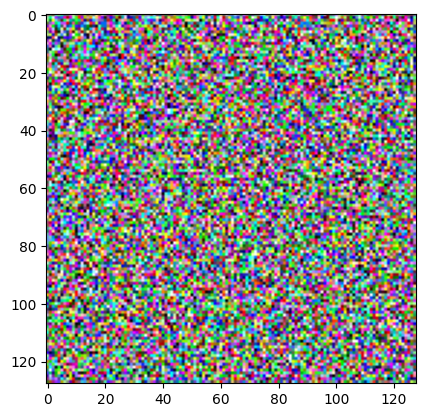

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9180717..2.4965124].


Added noise :


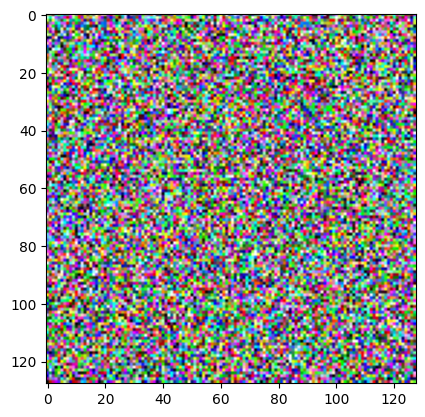

Training model:  70%|███████   | 511000/730000 [6:48:14<10:09:06,  5.99it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0222435..2.7239418].


Noisy image :


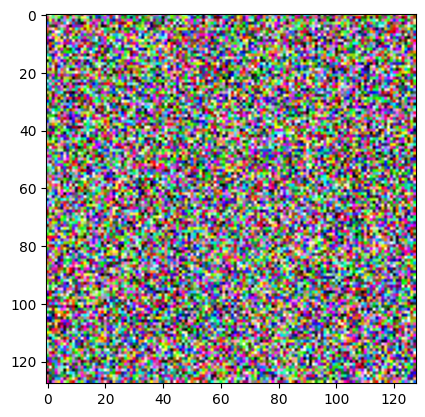

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.979444..2.567876].


Predict noise :


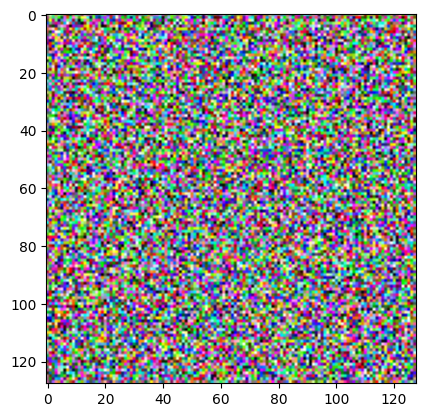

Added noise :


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0237255..2.7518678].


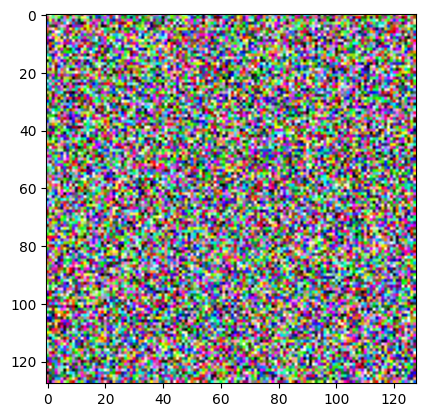

Training model:  72%|███████▏  | 525600/730000 [7:30:20<9:30:16,  5.97it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5674174..2.7711148].


Noisy image :


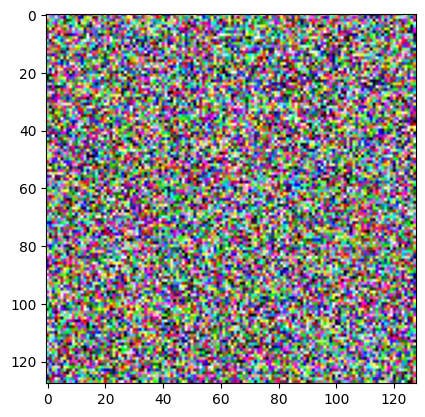

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5257888..2.691012].


Predict noise :


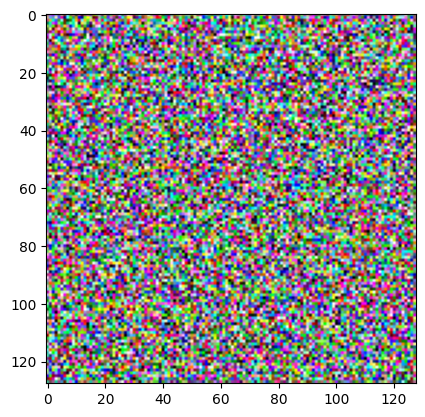

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5756047..2.7642086].


Added noise :


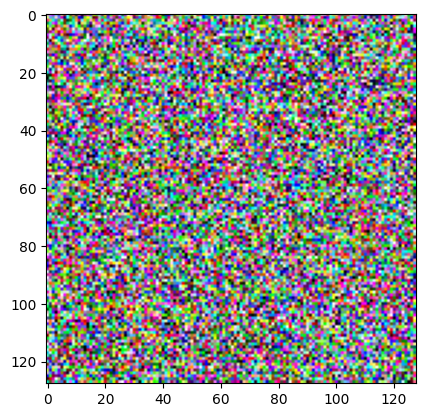

Training model:  74%|███████▍  | 540200/730000 [8:12:28<8:55:01,  5.91it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2370204..2.0813494].


Noisy image :


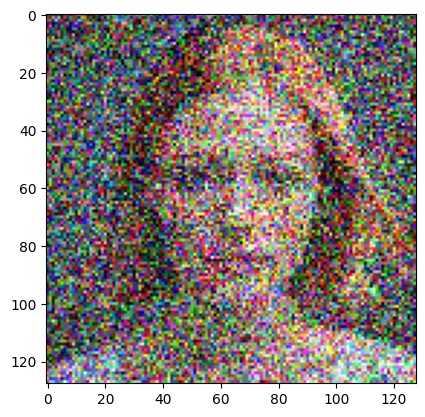

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7030301..2.5871265].


Predict noise :


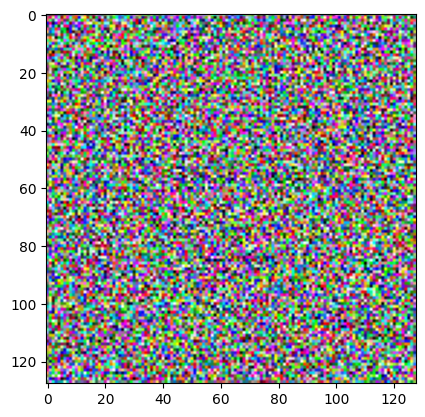

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.668967..2.704543].


Added noise :


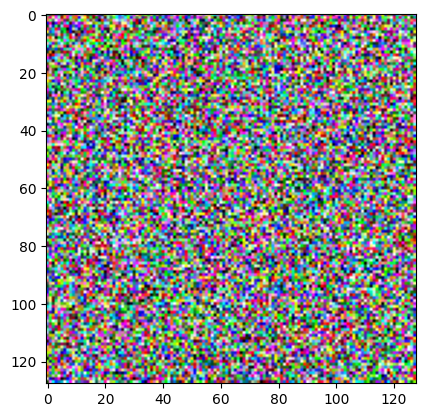

Training model:  76%|███████▌  | 554800/730000 [8:54:37<8:08:18,  5.98it/s] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5550075..2.5488038].


Noisy image :


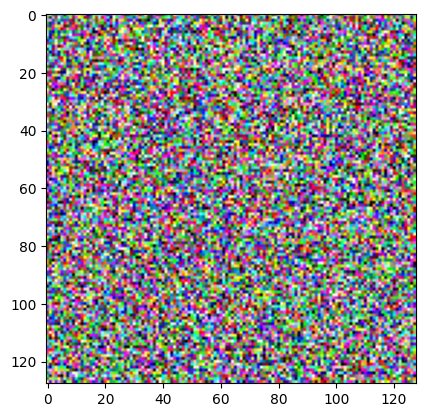

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3905191..2.4785113].


Predict noise :


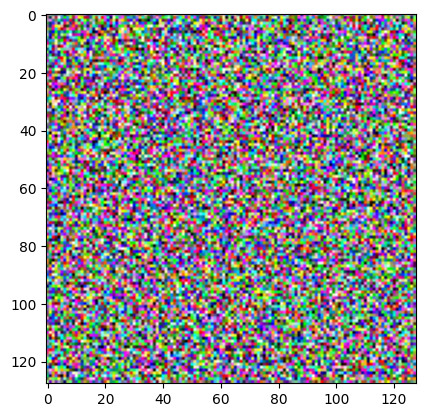

Added noise :


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5512283..2.549298].


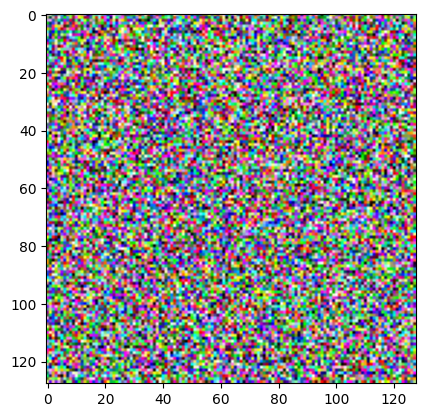

Training model:  78%|███████▊  | 566374/730000 [9:28:33<2:44:15, 16.60it/s] 


KeyboardInterrupt: 

In [10]:
def train_denoiser(model:UNet, ema:EMA) -> TrainResult:
    return resume_train_denoiser(model, ema, TrainResult(0, [], []))
    
def resume_train_denoiser(model:UNet, ema:EMA, train_result:TrainResult) -> TrainResult:

    sample_to_print = min(nb_sample_to_print, batch_size)
    epoch = train_result.epoch

    test_size:int = int(test_proportion * len(dataset))
    train_size:int = len(dataset) - test_size
    train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

    optimizer:torch.optim.Adam = torch.optim.AdamW(model.parameters(), lr=lr_scheduler(0), weight_decay=1e-5) # use weight_decay=1e-4 if not use EMA
    scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_scheduler)

    criterion:nn.MSELoss = nn.MSELoss()
    diffusion:DiffusionModel = DiffusionModel(model, optimizer, criterion, beta_schedule_type, timestep, device)

    print("Start training UNet")
    with tqdm.tqdm(total=epochs * len(train_dataset), desc="Training model") as pbar:
        pbar.update(epoch * len(train_dataset))
        for epoch in range(epoch, epochs):
            train_loader:DataLoader = DataLoader(train_dataset, batch_size, shuffle=True)
            input_batch:torch.Tensor = None
            total_loss:float = 0.0

            last_noisy_images_batch:torch.Tensor = None
            last_pred_noise_batch:torch.Tensor = None
            last_noise_batch:torch.Tensor = None
            for input_batch in train_loader:
                loss, noisy_images_batch, pred_noise_batch, noise_batch = diffusion.train_step(input_batch)

                if ema != None:
                    ema.update(model)

                last_noisy_images_batch = noisy_images_batch
                last_pred_noise_batch = pred_noise_batch
                last_noise_batch = noise_batch
                total_loss += loss
                pbar.update(input_batch.shape[0])
            
            scheduler.step()

            print_sample:bool = print_epoch_interval > 0 and ((epoch + 1) % print_epoch_interval == 0 or epoch + 1 == epochs)
            if print_sample:
                for i in range(0, sample_to_print):
                    noisy_image:torch.Tensor = last_noisy_images_batch[i] * 0.5 + 0.5
                    pred_noise:torch.Tensor = last_pred_noise_batch[i] * 0.5 + 0.5
                    noise:torch.Tensor = last_noise_batch[i] * 0.5 + 0.5
                    print("Noisy image :")
                    plt.imshow(noisy_image.permute(1, 2, 0))
                    plt.show()
                    print("Predict noise :")
                    plt.imshow(pred_noise.permute(1, 2, 0))
                    plt.show()
                    print("Added noise :")
                    plt.imshow(noise.permute(1, 2, 0))
                    plt.show()

            train_loss:float = total_loss / (len(train_dataset) / batch_size)
            train_result.train_losses.append(train_loss)

            with torch.no_grad():
                total_loss = 0.0
                test_loader:DataLoader = DataLoader(test_dataset, batch_size, shuffle=True)
                for input_batch in test_loader:
                    loss:torch.Tensor = diffusion.train_step_test(input_batch)
                    total_loss += loss
                train_result.test_losses.append(total_loss / (len(test_dataset) / batch_size))

            train_result.epoch = epoch
            train_res_path:str = "./Models/denoiser_train_result.txt"
            file = open(train_res_path, "w")
            file.write(train_result.to_json())
            file.close()

            path:str = f"./Models/denoiser.model"
            if os.path.isfile(path):
                os.remove(path)
            torch.save(model.state_dict(), path)

            if ema != None:
                path = f"./Models/ema_denoiser.model"
                if os.path.isfile(path):
                    os.remove(path)
                torch.save(ema.state_dict(), path)

            save_epoch:bool = saving_epoch_interval >= 1 and ((epoch + 1) % saving_epoch_interval == 0)
            if save_epoch:
                path = f"./Models/denoiser_epoch{epoch}.model"
                if os.path.isfile(path):
                    os.remove(path)
                torch.save(model.state_dict(), path)

                if ema != None:
                    path = f"./Models/ema_denoiser_epoch{epoch}.model"
                    if os.path.isfile(path):
                        os.remove(path)
                    torch.save(ema.state_dict(), path)

        return train_result
    
seed:int = 8476296554
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)

# denoiser:UNet = UNet(unet_setting.in_channels, unet_setting.base_channels, unet_setting.time_emb_dim, unet_setting.attention_resolutions, unet_setting.image_size)
# ema:EMA = EMA(denoiser, ema_decay)
# ema:EMA = None
# train_result:TrainResult = train_denoiser(denoiser, ema)

train_res_path:str = f"./Models/denoiser_train_result.txt"
file = open(train_res_path, "r")
train_result:TrainResult = TrainResult.from_json(file.read())
file.close()
denoiser:UNet = load_denoiser(f"denoiser.model")
# ema_model:UNet = load_denoiser(f"ema_denoiser.model")
# ema:EMA = EMA(ema_model, decay=ema_decay)
ema:EMA = None
train_result = resume_train_denoiser(denoiser, ema, train_result)

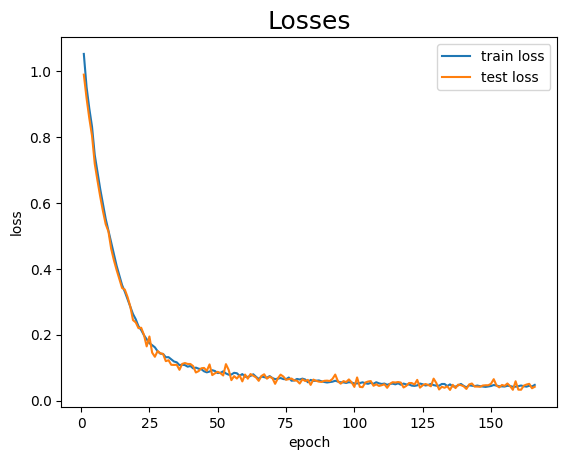

In [ ]:
def show_training_result(train_result:TrainResult, start_epoch:int=0, end_epoch:int=None) -> None:
    assert len(train_result.test_losses) == len(train_result.test_losses)
    X:list[float] = [float(i) for i in range(1, len(train_result.test_losses) + 1)]
    plt.plot(X[start_epoch:end_epoch], train_result.train_losses[start_epoch:end_epoch], label='train loss')
    plt.plot(X[start_epoch:end_epoch], train_result.test_losses[start_epoch:end_epoch], label='test loss')
    plt.title("Losses", fontsize=18)
    plt.xlabel("epoch")
    plt.ylabel("loss")
    plt.legend()
    plt.show()

train_res_path:str = f"./Models/denoiser_train_result.txt"
file = open(train_res_path, "r")
train_result:TrainResult = TrainResult.from_json(file.read())
file.close()
show_training_result(train_result, 0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5598..4.252038].


noisy image :


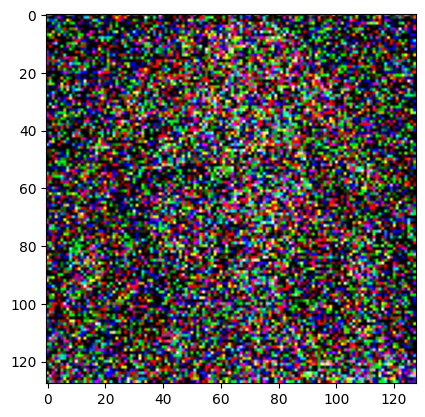

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.5502014..4.3294706].


noise :


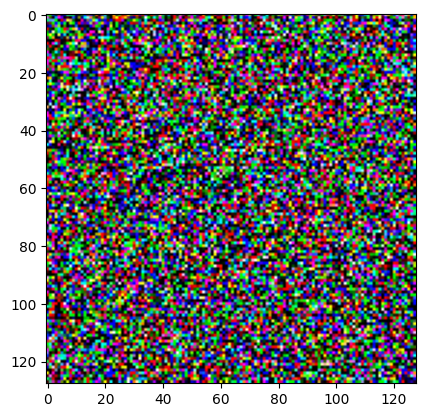

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.2932434..4.379059].


predicted noise:


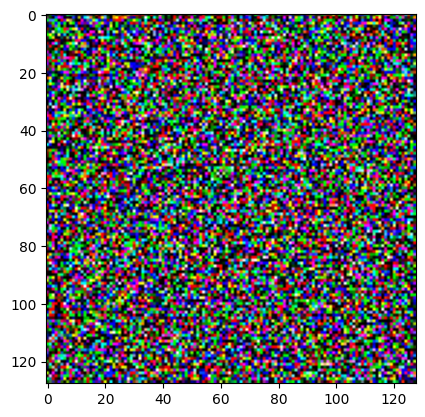

In [11]:
def test_model(diffusion_model:DiffusionModel, test_size:int) -> None:
    with torch.no_grad():
        x0:torch.Tensor = torch.stack([dataset[random.randint(0, len(dataset) - 1)] for _ in range(0, test_size)])
        t:torch.Tensor = torch.randint(0, diffusion_model.timesteps, (test_size,))
        xt, noise = diffusion_model._add_noise(x0, t)
        t = t.float().to(diffusion_model.device)
        pred_noise:torch.Tensor = diffusion_model.model(xt, t)

        for i in range(0, test_size):
            print("noisy image :")
            plt.imshow(xt[i].cpu().permute(1, 2, 0))
            plt.show()

            print("noise :")
            plt.imshow(noise[i].cpu().permute(1, 2, 0))
            plt.show()

            print("predicted noise:")
            plt.imshow(pred_noise[i].cpu().permute(1, 2, 0))
            plt.show()

denoiser:UNet = load_denoiser(f"denoiser.model")
diffusion_model:DiffusionModel = DiffusionModel(denoiser, None, None, beta_schedule_type, timestep, device)
test_model(diffusion_model, 1)

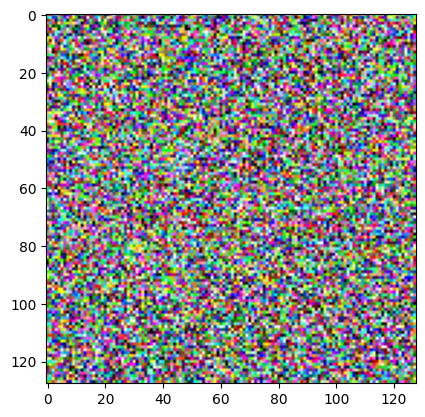

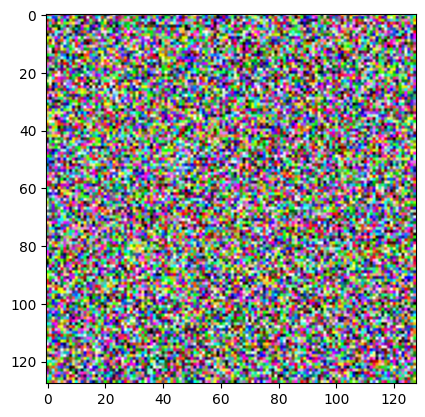

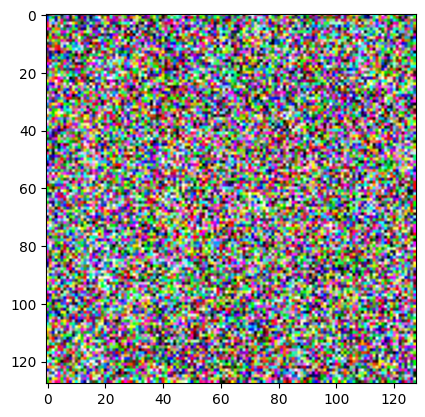

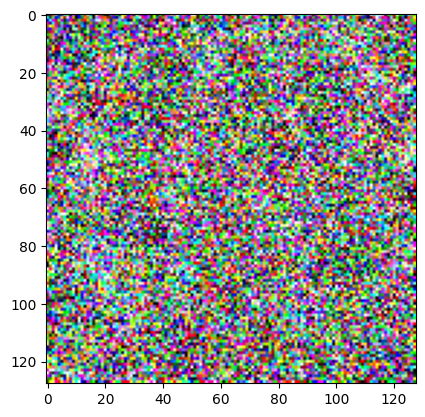

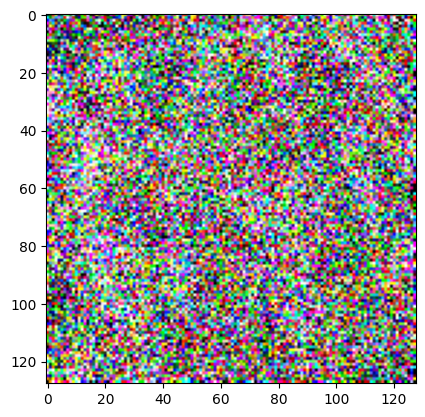

...

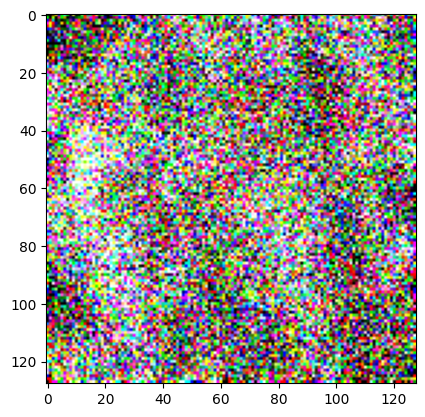

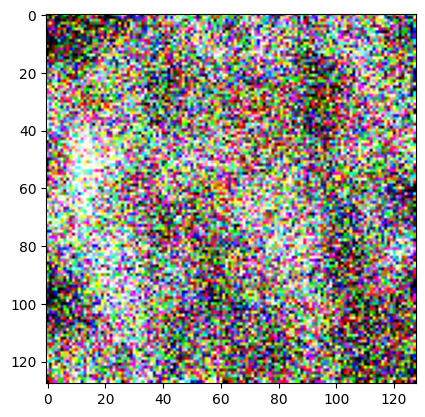

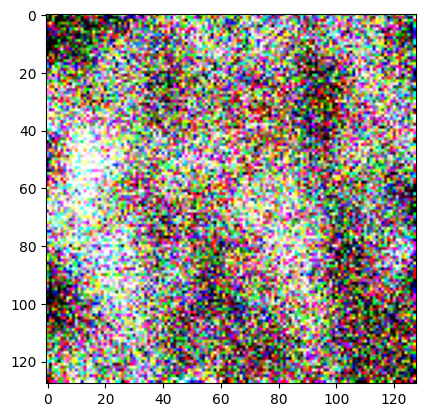

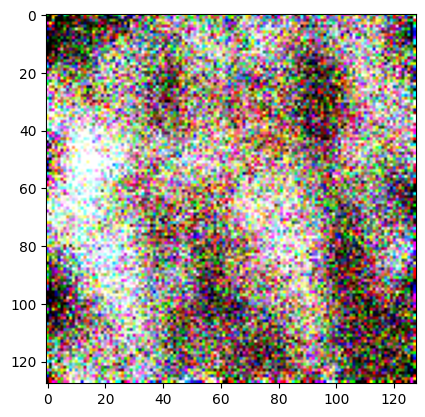

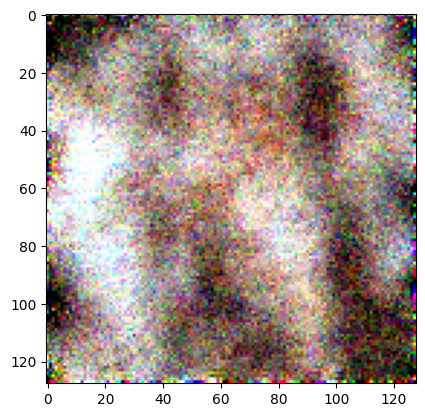

In [12]:
denoiser_name:str = "denoiser.model"
img_prefix:str = "v0.3_linear"
denoiser:UNet = load_denoiser(denoiser_name)
denoiser.eval()

diffusion_model:DiffusionModel = DiffusionModel(denoiser, None, None, beta_schedule_type, timestep, device)
samples:int = 1
images:torch.Tensor = diffusion_model.sample(samples, verbose=True)
for i in range(0, images.shape[0]):
    img:torch.Tensor = images[i].permute(1, 2, 0)
    plt.imshow(img)
    plt.show()

save_image:bool = False
if save_image:
    base_path:str = "./GeneratedImages"
    for i in range(0, images.shape[0]):
        now:datetime = datetime.now()
        local_path:str = f"{img_prefix}_{now.year}_{now.month}_{now.day}_{now.hour}_{now.minute}_{now.second}_{now.microsecond}_{denoiser_name}"
        img_path:str = os.path.join(base_path, f"{local_path}.png")
        torchvision.utils.save_image(images[i], img_path)